In [249]:
%matplotlib inline
import pandas as pd
import numpy as np
from matplotlib import pyplot as plt
import seaborn as sns
import seaborn as sbs
from sklearn.preprocessing import LabelEncoder
from sklearn.pipeline import Pipeline
import math
from sklearn import metrics
from mpl_toolkits.mplot3d import Axes3D
from sklearn.decomposition import PCA
from sklearn.linear_model import Perceptron
from sklearn.svm import SVC
from sklearn.cross_validation import train_test_split
from sklearn.metrics import confusion_matrix, classification_report
from sklearn.linear_model import LinearRegression
import warnings
from sklearn import datasets, linear_model
warnings.filterwarnings('ignore')
from sklearn import svm

## Reading the data

In [250]:
data = pd.read_csv('//home/students/aljamo01/KaggleV2-May-2016.csv')

In [251]:
data.head()

,PatientId,AppointmentID,Gender,ScheduledDay,AppointmentDay,Age,Neighbourhood,Scholarship,Hipertension,Diabetes,Alcoholism,Handcap,SMS_received,No-show
0,2.987250e+13,5642903,F,2016-04-29T18:38:08Z,2016-04-29T00:00:00Z,62,JARDIM DA PENHA,0,1,0,0,0,0,No
1,5.589978e+14,5642503,M,2016-04-29T16:08:27Z,2016-04-29T00:00:00Z,56,JARDIM DA PENHA,0,0,0,0,0,0,No
2,4.262962e+12,5642549,F,2016-04-29T16:19:04Z,2016-04-29T00:00:00Z,62,MATA DA PRAIA,0,0,0,0,0,0,No
3,8.679512e+11,5642828,F,2016-04-29T17:29:31Z,2016-04-29T00:00:00Z,8,PONTAL DE CAMBURI,0,0,0,0,0,0,No
4,8.841186e+12,5642494,F,2016-04-29T16:07:23Z,2016-04-29T00:00:00Z,56,JARDIM DA PENHA,0,1,1,0,0,0,No


## Variables:<br>
PatientId - Identification of a patient<br>
AppointmentID - Identification of each appointment <br>
Gender = Male or Female <br>
ScheduledDay = The day of the actuall appointment and the time, when they have to visit the doctor.<br>
Age = How old is the patient. <br>
Neighbourhood = Where the appointment takes place.<br>
Scholarship = Ture of False<br>
Hipertension = True or False<br>
Diabetes = True or False<br>
Alcoholism = True or False <br>
Handcap = True or False<br>
SMS_received = 1 or more messages sent to the patient.<br>
No-show = True or False.<br>

## rows = 110527


# Fixing the confusion in show up entries...

In [252]:
def showup (x):
    if x == "No":
        return "Yes"
    elif x == "Yes":
        return "No"

In [253]:
data['show_up'] = data['No-show'].apply(showup)

In [254]:
data.groupby('show_up').size()

show_up
No     22319
Yes    88208
dtype: int64

In [255]:
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 110527 entries, 0 to 110526
Data columns (total 15 columns):
PatientId         110527 non-null float64
AppointmentID     110527 non-null int64
Gender            110527 non-null object
ScheduledDay      110527 non-null object
AppointmentDay    110527 non-null object
Age               110527 non-null int64
Neighbourhood     110527 non-null object
Scholarship       110527 non-null int64
Hipertension      110527 non-null int64
Diabetes          110527 non-null int64
Alcoholism        110527 non-null int64
Handcap           110527 non-null int64
SMS_received      110527 non-null int64
No-show           110527 non-null object
show_up           110527 non-null object
dtypes: float64(1), int64(8), object(6)
memory usage: 12.6+ MB


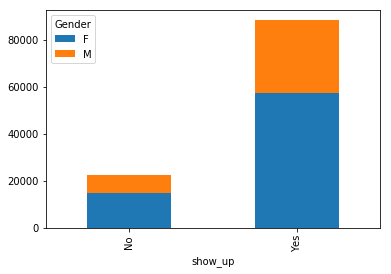

In [256]:
df2 = data[['show_up', 'Gender']].groupby(['show_up', 'Gender'])['Gender'].count().unstack('Gender')
df2.plot(kind='bar', stacked=True)

In [257]:
no_show = data.loc[data.show_up == 'No']
show = data.loc[data.show_up == 'Yes']

len(no_show)/(len(no_show)+len(show))

0.20193255946510807

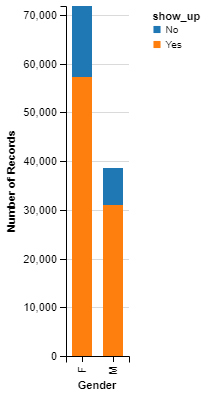

In [258]:
import altair
altair.Chart(data, max_rows=120000).mark_bar().encode(x='Gender', y='count(*)', color = 'show_up')

# Cleanning the data

## Extracting the appointment day, month from the date format in the AppointmentDay feature.
## Exracting the Appointment hour from the ScheduledDay.

In [259]:
data['AppointmentDay'] = pd.to_datetime(data['AppointmentDay'])
data['Month'] = data['AppointmentDay'].dt.month
data['day_of_week'] = data['AppointmentDay'].dt.dayofweek
data['ScheduledDay'] = pd.to_datetime(data['ScheduledDay'])
data['Appointment_Hour'] = data['ScheduledDay'].dt.hour

In [260]:
data.head()

,PatientId,AppointmentID,Gender,ScheduledDay,AppointmentDay,Age,Neighbourhood,Scholarship,Hipertension,Diabetes,Alcoholism,Handcap,SMS_received,No-show,show_up,Month,day_of_week,Appointment_Hour
0,2.987250e+13,5642903,F,2016-04-29 18:38:08,2016-04-29,62,JARDIM DA PENHA,0,1,0,0,0,0,No,Yes,4,4,18
1,5.589978e+14,5642503,M,2016-04-29 16:08:27,2016-04-29,56,JARDIM DA PENHA,0,0,0,0,0,0,No,Yes,4,4,16
2,4.262962e+12,5642549,F,2016-04-29 16:19:04,2016-04-29,62,MATA DA PRAIA,0,0,0,0,0,0,No,Yes,4,4,16
3,8.679512e+11,5642828,F,2016-04-29 17:29:31,2016-04-29,8,PONTAL DE CAMBURI,0,0,0,0,0,0,No,Yes,4,4,17
4,8.841186e+12,5642494,F,2016-04-29 16:07:23,2016-04-29,56,JARDIM DA PENHA,0,1,1,0,0,0,No,Yes,4,4,16


## Giving the feature day_of_week the day names.

In [261]:
days = {0:'Mon',1:'Tues',2:'Weds',3:'Thurs',4:'Fri',5:'Sat',6:'Sun'}
data['day_of_week'] = data['day_of_week'].apply(lambda x: days[x])

In [262]:
data.head()

,PatientId,AppointmentID,Gender,ScheduledDay,AppointmentDay,Age,Neighbourhood,Scholarship,Hipertension,Diabetes,Alcoholism,Handcap,SMS_received,No-show,show_up,Month,day_of_week,Appointment_Hour
0,2.987250e+13,5642903,F,2016-04-29 18:38:08,2016-04-29,62,JARDIM DA PENHA,0,1,0,0,0,0,No,Yes,4,Fri,18
1,5.589978e+14,5642503,M,2016-04-29 16:08:27,2016-04-29,56,JARDIM DA PENHA,0,0,0,0,0,0,No,Yes,4,Fri,16
2,4.262962e+12,5642549,F,2016-04-29 16:19:04,2016-04-29,62,MATA DA PRAIA,0,0,0,0,0,0,No,Yes,4,Fri,16
3,8.679512e+11,5642828,F,2016-04-29 17:29:31,2016-04-29,8,PONTAL DE CAMBURI,0,0,0,0,0,0,No,Yes,4,Fri,17
4,8.841186e+12,5642494,F,2016-04-29 16:07:23,2016-04-29,56,JARDIM DA PENHA,0,1,1,0,0,0,No,Yes,4,Fri,16


## Categorizing the age variable into Young, Adult, and Senior Adult. Categorizing the time of the day into Morning, Noon, Afternoon, Night, and Very Late.

In [263]:
def age(x):
    if x < 18:
        return "Young (Less than 18)"
    elif x >= 18 and x <= 60:
        return "Adult"
    else:
        return "Senior Adult"
    
def partofday(x):
    if x >= 6 and x  <= 11:
        return "Morning"
    elif x == 12:
        return "Noon"
    elif x >= 13 and x <= 17:
        return "Afternoon"
    elif x >= 18 and x <= 24:
        return "Night"
    else:
        return "Very Late"



In [264]:
data['AgeCategory'] = data['Age'].apply(age)
data['TimeofDay'] = data['Appointment_Hour'].apply(partofday)

In [265]:
data.head()

,PatientId,AppointmentID,Gender,ScheduledDay,AppointmentDay,Age,Neighbourhood,Scholarship,Hipertension,Diabetes,Alcoholism,Handcap,SMS_received,No-show,show_up,Month,day_of_week,Appointment_Hour,AgeCategory,TimeofDay
0,2.987250e+13,5642903,F,2016-04-29 18:38:08,2016-04-29,62,JARDIM DA PENHA,0,1,0,0,0,0,No,Yes,4,Fri,18,Senior Adult,Night
1,5.589978e+14,5642503,M,2016-04-29 16:08:27,2016-04-29,56,JARDIM DA PENHA,0,0,0,0,0,0,No,Yes,4,Fri,16,Adult,Afternoon
2,4.262962e+12,5642549,F,2016-04-29 16:19:04,2016-04-29,62,MATA DA PRAIA,0,0,0,0,0,0,No,Yes,4,Fri,16,Senior Adult,Afternoon
3,8.679512e+11,5642828,F,2016-04-29 17:29:31,2016-04-29,8,PONTAL DE CAMBURI,0,0,0,0,0,0,No,Yes,4,Fri,17,Young (Less than 18),Afternoon
4,8.841186e+12,5642494,F,2016-04-29 16:07:23,2016-04-29,56,JARDIM DA PENHA,0,1,1,0,0,0,No,Yes,4,Fri,16,Adult,Afternoon


Drop the the unnecessary features. 

In [266]:
data = data.drop(['ScheduledDay','AppointmentDay','No-show','AppointmentID','Neighbourhood'],1)

In [267]:
data.head()

,PatientId,Gender,Age,Scholarship,Hipertension,Diabetes,Alcoholism,Handcap,SMS_received,show_up,Month,day_of_week,Appointment_Hour,AgeCategory,TimeofDay
0,2.987250e+13,F,62,0,1,0,0,0,0,Yes,4,Fri,18,Senior Adult,Night
1,5.589978e+14,M,56,0,0,0,0,0,0,Yes,4,Fri,16,Adult,Afternoon
2,4.262962e+12,F,62,0,0,0,0,0,0,Yes,4,Fri,16,Senior Adult,Afternoon
3,8.679512e+11,F,8,0,0,0,0,0,0,Yes,4,Fri,17,Young (Less than 18),Afternoon
4,8.841186e+12,F,56,0,1,1,0,0,0,Yes,4,Fri,16,Adult,Afternoon


In [268]:
data.groupby(['show_up']).size()

show_up
No     22319
Yes    88208
dtype: int64

## Exploration (Visualization)

## Distribution of Shows and No shows among different variables, and percentile distribution.

## Age Category

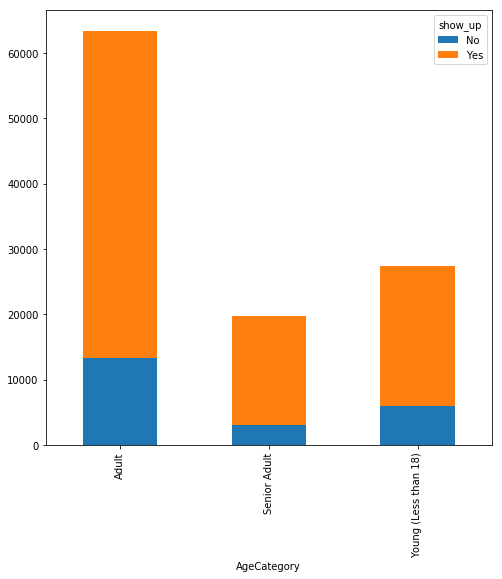

In [269]:
age = pd.crosstab(data.AgeCategory, data.show_up)
age.plot(kind="bar", 
                 figsize=(8,8),
                 stacked=True)

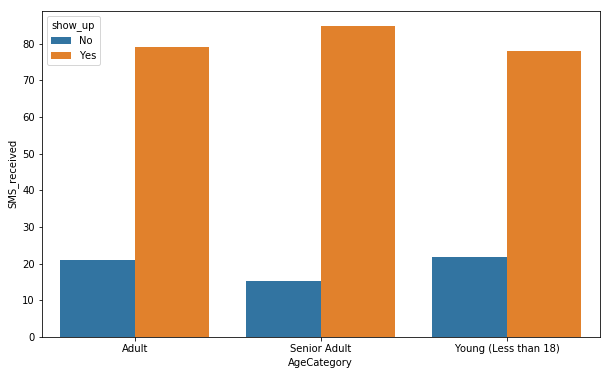

In [270]:
impact={}
groups = data[['AgeCategory', 'show_up','SMS_received']].groupby(['AgeCategory', 'show_up']).count()
groups = groups = groups.groupby(level=0).apply(lambda x: 100 * x / float(x.sum())).reset_index()
std = groups.query('show_up=="No"')['SMS_received'].std()
impact['AgeCategory'] = std
fig, ax = plt.subplots(figsize=(10,6))
sbs.barplot(y="SMS_received", x="AgeCategory", hue="show_up", data=groups)

## Week days

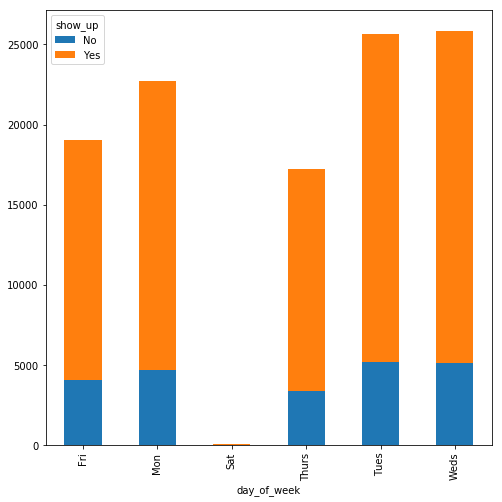

In [271]:
day = pd.crosstab(data.day_of_week, data.show_up)
day.plot(kind="bar", 
                 figsize=(8,8),
                 stacked=True)

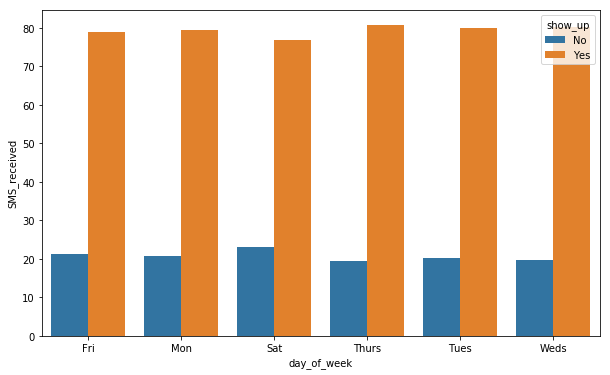

In [272]:
impact={}
groups = data[['day_of_week', 'show_up','SMS_received']].groupby(['day_of_week', 'show_up']).count()
groups = groups = groups.groupby(level=0).apply(lambda x: 100 * x / float(x.sum())).reset_index()
std = groups.query('show_up=="No"')['SMS_received'].std()
impact['day_of_week'] = std
fig, ax = plt.subplots(figsize=(10,6))
sbs.barplot(y="SMS_received", x="day_of_week", hue="show_up", data=groups)

## Time of the day

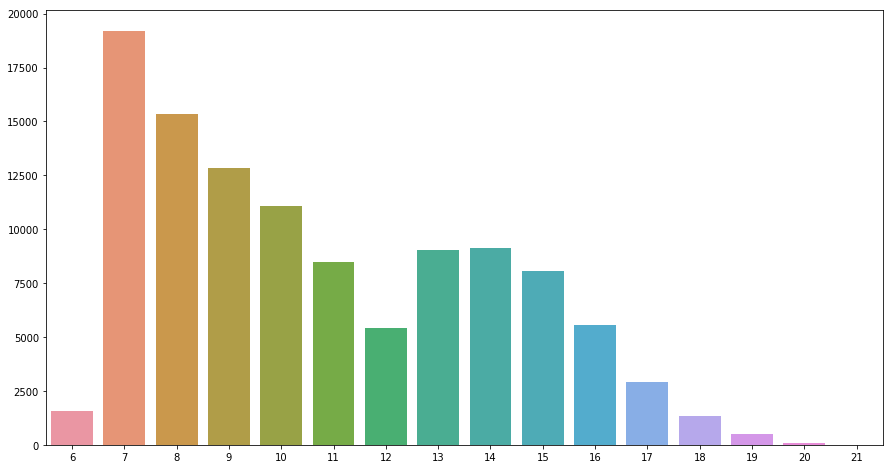

In [273]:
groups = data.groupby(['Appointment_Hour'])
gps = groups.size()
fig, ax = plt.subplots(figsize=(15,8))
sbs.barplot(x=gps.index.tolist(), y=gps.values)

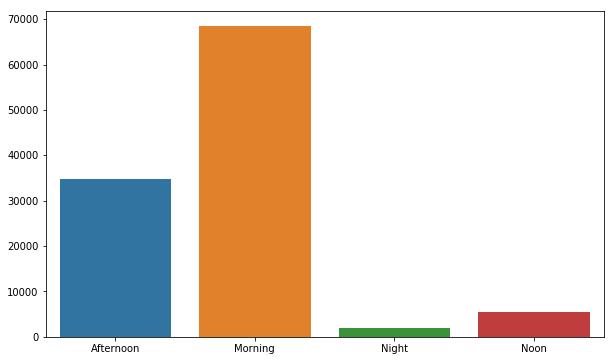

In [274]:
groups = data.groupby(['TimeofDay'])
gps = groups.size()
fig, ax = plt.subplots(figsize=(10,6))
sbs.barplot(x=gps.index.tolist(), y=gps.values)

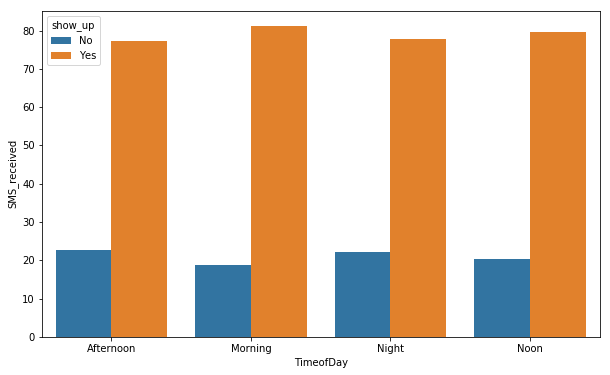

In [275]:
impact={}
groups = data[['TimeofDay', 'show_up','SMS_received']].groupby(['TimeofDay', 'show_up']).count()
groups = groups = groups.groupby(level=0).apply(lambda x: 100 * x / float(x.sum())).reset_index()
std = groups.query('show_up=="No"')['SMS_received'].std()
impact['TimeofDay'] = std
fig, ax = plt.subplots(figsize=(10,6))
sbs.barplot(y="SMS_received", x="TimeofDay", hue="show_up", data=groups)

# Pivot Tables

## Show ups in each Condition

In [276]:
pv = data.pivot_table(values=["Diabetes","Alcoholism","Hipertension","Handcap","SMS_received"]
                         ,columns="show_up", aggfunc=np.sum)

In [277]:
data1 = pv.unstack().unstack('show_up').reset_index().rename(columns={"level_0":"Category"})
data1

show_up,index,No,Yes
0,Alcoholism,677,2683
1,Diabetes,1430,6513
2,Handcap,453,2006
3,Hipertension,3772,18029
4,SMS_received,9784,25698


In [278]:
data1['Total'] = data1['No'] + data1['Yes']
data1["No-Show-Rate"] = data1['No'] / (data1['No'] + data1['Yes'])

In [279]:
data1

show_up,index,No,Yes,Total,No-Show-Rate
0,Alcoholism,677,2683,3360,0.201488
1,Diabetes,1430,6513,7943,0.180033
2,Handcap,453,2006,2459,0.184221
3,Hipertension,3772,18029,21801,0.173020
4,SMS_received,9784,25698,35482,0.275745


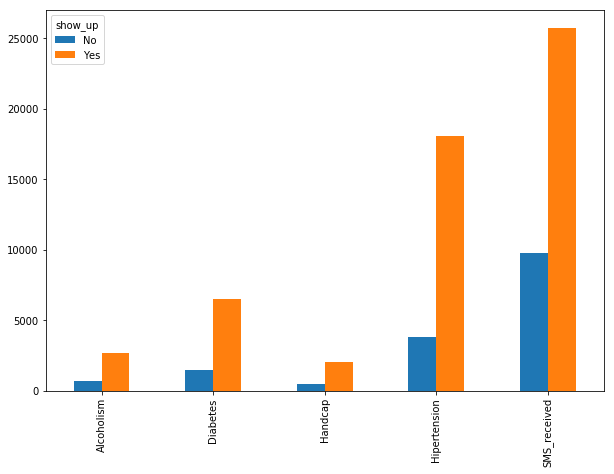

In [280]:
pv.loc[:,['No', 'Yes']].plot.bar(stacked=False, figsize=(10,7))

In [281]:
data.head()

,PatientId,Gender,Age,Scholarship,Hipertension,Diabetes,Alcoholism,Handcap,SMS_received,show_up,Month,day_of_week,Appointment_Hour,AgeCategory,TimeofDay
0,2.987250e+13,F,62,0,1,0,0,0,0,Yes,4,Fri,18,Senior Adult,Night
1,5.589978e+14,M,56,0,0,0,0,0,0,Yes,4,Fri,16,Adult,Afternoon
2,4.262962e+12,F,62,0,0,0,0,0,0,Yes,4,Fri,16,Senior Adult,Afternoon
3,8.679512e+11,F,8,0,0,0,0,0,0,Yes,4,Fri,17,Young (Less than 18),Afternoon
4,8.841186e+12,F,56,0,1,1,0,0,0,Yes,4,Fri,16,Adult,Afternoon


## Show ups in each condition considering the time of the day

In [282]:
pv1 = data.pivot_table(values=["Diabetes","Alcoholism","Hipertension","Handcap","SMS_received"]
                         ,columns="show_up", index='TimeofDay', aggfunc=np.sum)
data2 = pv1.unstack().unstack('show_up').reset_index().rename(columns={"level_0":"Category"})

In [283]:
data2['Total'] = data2['No'] + data2['Yes']

In [284]:
data2["No-Show-Rate"] = data2['No'] / (data2['No'] + data2['Yes'])

In [285]:
data2

show_up,Category,TimeofDay,No,Yes,Total,No-Show-Rate
0,Alcoholism,Afternoon,212,743,955,0.221990
1,Alcoholism,Morning,421,1730,2151,0.195723
2,Alcoholism,Night,16,46,62,0.258065
3,Alcoholism,Noon,28,164,192,0.145833
4,Diabetes,Afternoon,485,1820,2305,0.210412
5,Diabetes,Morning,847,4244,5091,0.166372
6,Diabetes,Night,20,96,116,0.172414
7,Diabetes,Noon,78,353,431,0.180974
8,Handcap,Afternoon,148,642,790,0.187342
9,Handcap,Morning,280,1254,1534,0.182529


## Show ups in each condition considering Age category

In [286]:
pv2 = data.pivot_table(values=["Diabetes","Alcoholism","Hipertension","Handcap","SMS_received"]
                         ,columns="show_up",index="AgeCategory", aggfunc=np.sum)

In [287]:
data3 = pv2.unstack().unstack('show_up').reset_index().rename(columns={"level_0":"Category"})

In [288]:
data3['Total'] = data3['No'] + data3['Yes']
data3["No-Show-Rate"] = data3['No'] / (data3['No'] + data3['Yes'])

In [289]:
data3

show_up,Category,AgeCategory,No,Yes,Total,No-Show-Rate
0,Alcoholism,Adult,569,2032,2601,0.218762
1,Alcoholism,Senior Adult,96,639,735,0.130612
2,Alcoholism,Young (Less than 18),12,12,24,0.500000
3,Diabetes,Adult,684,2821,3505,0.195150
4,Diabetes,Senior Adult,730,3657,4387,0.166401
5,Diabetes,Young (Less than 18),16,35,51,0.313725
6,Handcap,Adult,215,1056,1271,0.169158
7,Handcap,Senior Adult,154,748,902,0.170732
8,Handcap,Young (Less than 18),84,202,286,0.293706
9,Hipertension,Adult,1998,8763,10761,0.185670


## Show ups in each condition considering Week day

In [290]:
pv3 = data.pivot_table(values=["Diabetes","Alcoholism","Hipertension","Handcap","SMS_received"]
                         ,columns="show_up", index='day_of_week', aggfunc=np.sum)

In [291]:
data4 = pv3.unstack().unstack('show_up').reset_index().rename(columns={"level_0":"Category"})

In [292]:
data4['Total'] = data4['No'] + data4['Yes']
data4["No-Show-Rate"] = data4['No'] / (data4['No'] + data4['Yes'])

In [293]:
data4

show_up,Category,day_of_week,No,Yes,Total,No-Show-Rate
0,Alcoholism,Fri,116,492,608,0.190789
1,Alcoholism,Mon,160,544,704,0.227273
2,Alcoholism,Sat,0,2,2,0.000000
3,Alcoholism,Thurs,101,417,518,0.194981
4,Alcoholism,Tues,164,574,738,0.222222
5,Alcoholism,Weds,136,654,790,0.172152
6,Diabetes,Fri,287,1176,1463,0.196172
7,Diabetes,Mon,328,1243,1571,0.208784
8,Diabetes,Sat,2,5,7,0.285714
9,Diabetes,Thurs,202,1001,1203,0.167914


## From the pivot tables we realize that the no show rates are always around 20 percent in almost all conditions.. Interestingly SMS recieved shows high no show percentages.

# Label Encoding <br>
## Correlation?

In [294]:
data.head()

,PatientId,Gender,Age,Scholarship,Hipertension,Diabetes,Alcoholism,Handcap,SMS_received,show_up,Month,day_of_week,Appointment_Hour,AgeCategory,TimeofDay
0,2.987250e+13,F,62,0,1,0,0,0,0,Yes,4,Fri,18,Senior Adult,Night
1,5.589978e+14,M,56,0,0,0,0,0,0,Yes,4,Fri,16,Adult,Afternoon
2,4.262962e+12,F,62,0,0,0,0,0,0,Yes,4,Fri,16,Senior Adult,Afternoon
3,8.679512e+11,F,8,0,0,0,0,0,0,Yes,4,Fri,17,Young (Less than 18),Afternoon
4,8.841186e+12,F,56,0,1,1,0,0,0,Yes,4,Fri,16,Adult,Afternoon


In [295]:
Labels = ['Gender', 'show_up', 'day_of_week', 'AgeCategory','TimeofDay']

In [296]:
labelencoder = LabelEncoder()
for x in data.columns:
    if x in Labels:
        data[x] = labelencoder.fit_transform(data[x])

In [297]:
data.head()

,PatientId,Gender,Age,Scholarship,Hipertension,Diabetes,Alcoholism,Handcap,SMS_received,show_up,Month,day_of_week,Appointment_Hour,AgeCategory,TimeofDay
0,2.987250e+13,0,62,0,1,0,0,0,0,1,4,0,18,1,2
1,5.589978e+14,1,56,0,0,0,0,0,0,1,4,0,16,0,0
2,4.262962e+12,0,62,0,0,0,0,0,0,1,4,0,16,1,0
3,8.679512e+11,0,8,0,0,0,0,0,0,1,4,0,17,2,0
4,8.841186e+12,0,56,0,1,1,0,0,0,1,4,0,16,0,0


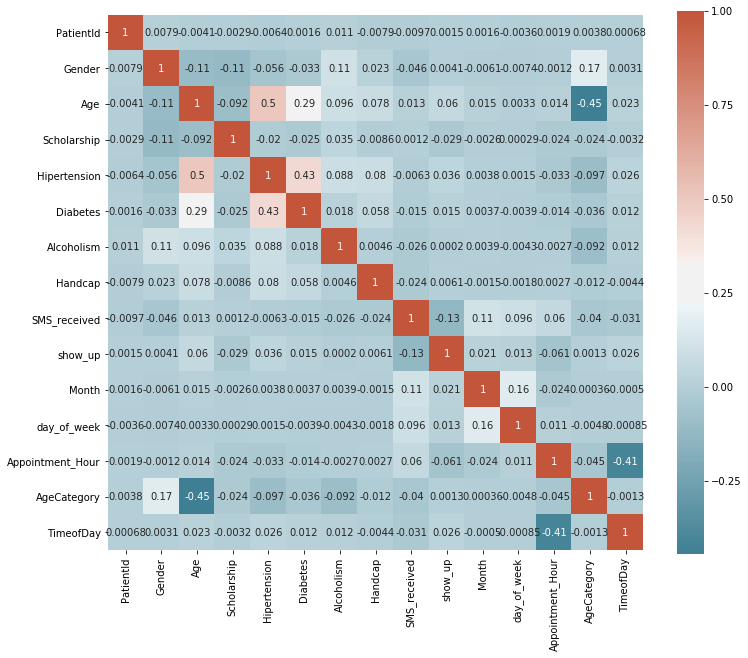

In [298]:
corr = data.corr()
fig, ax = plt.subplots(figsize=(12, 10))
cmap = sns.diverging_palette(220, 20, sep=20,as_cmap=True)
fig = sns.heatmap( corr, cmap=cmap, square=True, ax=ax, annot=True )
plt.show()

# Classifications

In [299]:
X = data.drop(['PatientId', 'show_up'],1)
y = data[['show_up']]

In [300]:
from sklearn.model_selection import train_test_split
X_train, X_test, y_train, y_test = train_test_split(X,y,test_size=0.2,random_state=2018)

## Logistic 

In [301]:
from sklearn.linear_model import LogisticRegression
regressor = LogisticRegression()
regressor.fit(X_train, y_train)
y_pred2 = regressor.predict(X_test)
y_pred2

array([1, 1, 1, ..., 1, 1, 1])

In [302]:
from sklearn.metrics import accuracy_score
l_ac = accuracy_score(y_test, y_pred2)
l_ac

0.8019994571609518

In [303]:
from sklearn.metrics import confusion_matrix
binary = confusion_matrix(y_test, y_pred2)
binary

array([[    0,  4377],
       [    0, 17729]])

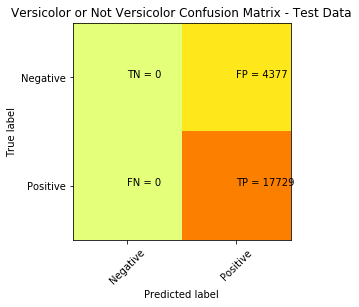

In [304]:
plt.clf()
plt.imshow(binary, interpolation='nearest', cmap=plt.cm.Wistia)
classNames = ['Negative','Positive']
plt.title('Versicolor or Not Versicolor Confusion Matrix - Test Data')
plt.ylabel('True label')
plt.xlabel('Predicted label')
tick_marks = np.arange(len(classNames))
plt.xticks(tick_marks, classNames, rotation=45)
plt.yticks(tick_marks, classNames)
s = [['TN','FP'], ['FN', 'TP']]
for i in range(2):
    for j in range(2):
        plt.text(j,i, str(s[i][j])+" = "+str(binary[i][j]))
plt.show()

In [305]:
from sklearn.metrics import roc_auc_score
LR_r = roc_auc_score(y_test, y_pred2)
LR_r

0.5

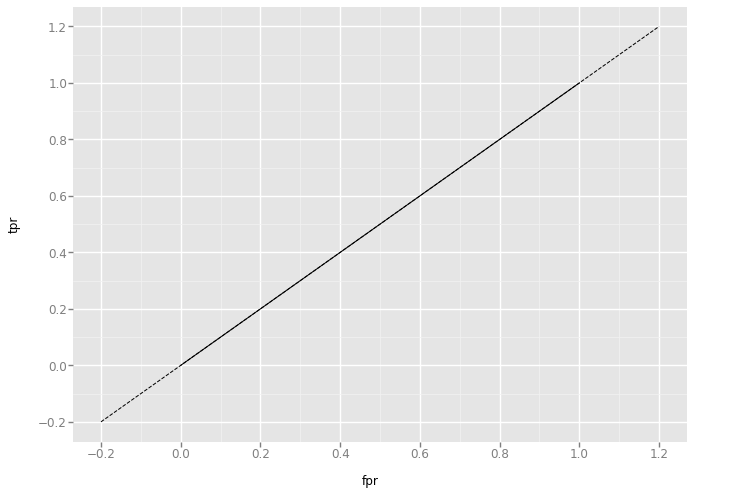

<ggplot: (-9223363280575999919)>

In [306]:
from sklearn import metrics
import pandas as pd
from ggplot import *

#preds = clf.predict_proba(Xtest)[:,1]
fpr, tpr, _ = metrics.roc_curve(y_test, y_pred2)

df = pd.DataFrame(dict(fpr=fpr, tpr=tpr))
ggplot(df, aes(x='fpr', y='tpr')) +\
 geom_line() +\
    geom_abline(linetype='dashed')

## Bayes

In [307]:
from sklearn.naive_bayes import GaussianNB
gnb = GaussianNB()
y_pred1 = gnb.fit(X_train, y_train)

In [308]:
y_pred1 = gnb.predict(X_test)

In [309]:
b_ac = accuracy_score(y_test, y_pred1)
b_ac

0.7943544738984891

In [310]:
binary1 = confusion_matrix(y_test, y_pred1)
binary1

array([[  210,  4167],
       [  379, 17350]])

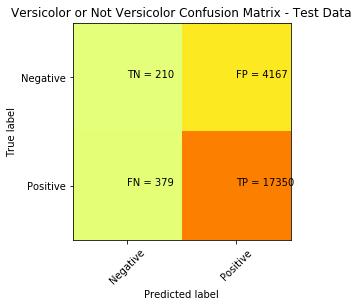

In [311]:
plt.clf()
plt.imshow(binary1, interpolation='nearest', cmap=plt.cm.Wistia)
classNames = ['Negative','Positive']
plt.title('Versicolor or Not Versicolor Confusion Matrix - Test Data')
plt.ylabel('True label')
plt.xlabel('Predicted label')
tick_marks = np.arange(len(classNames))
plt.xticks(tick_marks, classNames, rotation=45)
plt.yticks(tick_marks, classNames)
s = [['TN','FP'], ['FN', 'TP']]
for i in range(2):
    for j in range(2):
        plt.text(j,i, str(s[i][j])+" = "+str(binary1[i][j]))
plt.show()

In [312]:
B_r =roc_auc_score(y_test, y_pred1)
B_r

0.5133003314581875

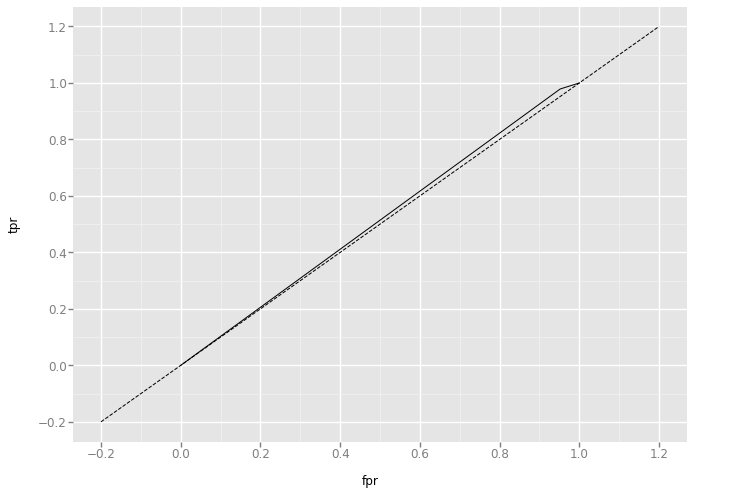

<ggplot: (-9223363280575939107)>

In [313]:
fpr, tpr, _ = metrics.roc_curve(y_test, y_pred1)

df = pd.DataFrame(dict(fpr=fpr, tpr=tpr))
ggplot(df, aes(x='fpr', y='tpr')) +\
 geom_line() +\
    geom_abline(linetype='dashed')

## Decision Tree

In [314]:
from sklearn.tree import DecisionTreeClassifier
model_tree = DecisionTreeClassifier()

In [315]:
model_tree.fit(X_train, y_train)

DecisionTreeClassifier(class_weight=None, criterion='gini', max_depth=None,
            max_features=None, max_leaf_nodes=None,
            min_impurity_decrease=0.0, min_impurity_split=None,
            min_samples_leaf=1, min_samples_split=2,
            min_weight_fraction_leaf=0.0, presort=False, random_state=None,
            splitter='best')

In [316]:
y_pred3 = model_tree.predict(X_test)

In [317]:
DT_ac = accuracy_score(y_test, y_pred3)
DT_ac

0.7032479869718629

In [318]:
binary3 = confusion_matrix(y_test, y_pred3)
binary3

array([[ 1142,  3235],
       [ 3325, 14404]])

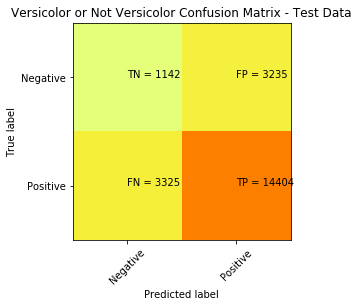

In [319]:
plt.clf()
plt.imshow(binary3, interpolation='nearest', cmap=plt.cm.Wistia)
classNames = ['Negative','Positive']
plt.title('Versicolor or Not Versicolor Confusion Matrix - Test Data')
plt.ylabel('True label')
plt.xlabel('Predicted label')
tick_marks = np.arange(len(classNames))
plt.xticks(tick_marks, classNames, rotation=45)
plt.yticks(tick_marks, classNames)
s = [['TN','FP'], ['FN', 'TP']]
for i in range(2):
    for j in range(2):
        plt.text(j,i, str(s[i][j])+" = "+str(binary3[i][j]))
plt.show()

In [320]:
DT_r = roc_auc_score(y_test, y_pred3)
DT_r

0.5366817348691975

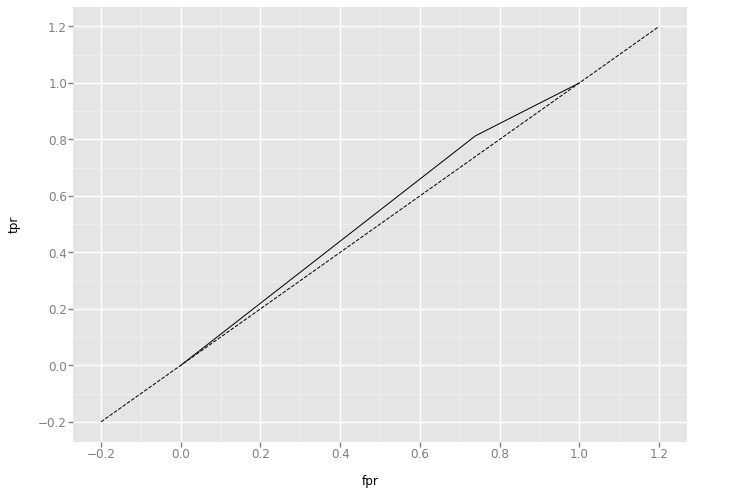

<ggplot: (8756278836544)>

In [321]:
fpr, tpr, _ = metrics.roc_curve(y_test, y_pred3)

df = pd.DataFrame(dict(fpr=fpr, tpr=tpr))
ggplot(df, aes(x='fpr', y='tpr')) +\
 geom_line() +\
    geom_abline(linetype='dashed')

## Random Forest

In [322]:
from sklearn.ensemble import RandomForestClassifier
model_RR = RandomForestClassifier(5)

In [323]:
model_RR.fit(X_train, y_train)

RandomForestClassifier(bootstrap=True, class_weight=None, criterion='gini',
            max_depth=None, max_features='auto', max_leaf_nodes=None,
            min_impurity_decrease=0.0, min_impurity_split=None,
            min_samples_leaf=1, min_samples_split=2,
            min_weight_fraction_leaf=0.0, n_estimators=5, n_jobs=1,
            oob_score=False, random_state=None, verbose=0,
            warm_start=False)

In [324]:
y_pred4 = model_RR.predict(X_test)

In [325]:
RF_ac = accuracy_score(y_test, y_pred4)
RF_ac

0.7392110739165837

In [326]:
binary2 = confusion_matrix(y_test, y_pred4)
binary2

array([[  865,  3512],
       [ 2253, 15476]])

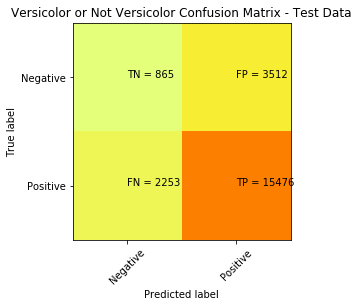

In [327]:
plt.clf()
plt.imshow(binary2, interpolation='nearest', cmap=plt.cm.Wistia)
classNames = ['Negative','Positive']
plt.title('Versicolor or Not Versicolor Confusion Matrix - Test Data')
plt.ylabel('True label')
plt.xlabel('Predicted label')
tick_marks = np.arange(len(classNames))
plt.xticks(tick_marks, classNames, rotation=45)
plt.yticks(tick_marks, classNames)
s = [['TN','FP'], ['FN', 'TP']]
for i in range(2):
    for j in range(2):
        plt.text(j,i, str(s[i][j])+" = "+str(binary2[i][j]))
plt.show()

In [328]:
RF_r = roc_auc_score(y_test, y_pred4)
RF_r

0.5352720088972356

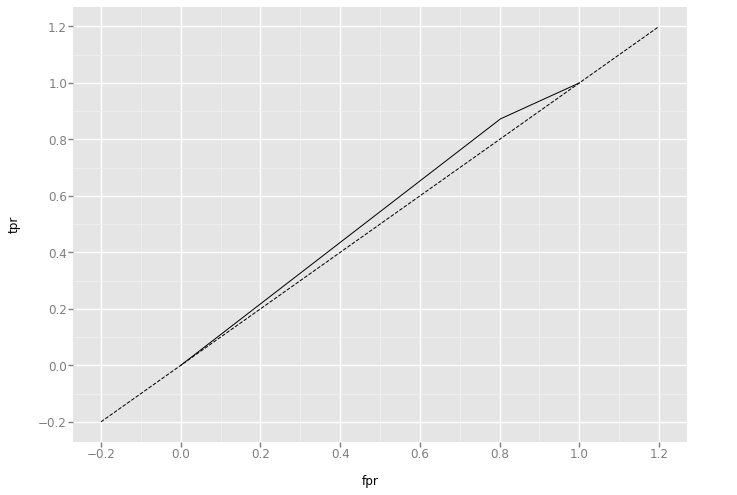

<ggplot: (-9223363280576082025)>

In [329]:
fpr, tpr, _ = metrics.roc_curve(y_test, y_pred4)

df = pd.DataFrame(dict(fpr=fpr, tpr=tpr))
ggplot(df, aes(x='fpr', y='tpr')) +\
 geom_line() +\
    geom_abline(linetype='dashed')

# Classificaions Comparison Summary 

In [330]:
print('All Results')
print ('\n Accuracy Scores:')
print ('\t Logisitic', l_ac)
print ('\t Bayes', b_ac)
print ('\t Decision tree', DT_ac)
print ('\t random Forest', RF_ac)

print ('\n Confusion Matrix:')
print (' Logisitic','\n', binary)
print (' Bayes','\n', binary1)
print (' Decision tree','\n', binary3)
print (' random Forest','\n', binary2)

print ('\n ROC Accuracy Scores:')
print ('\t Logisitic', LR_r)
print ('\t Bayes', B_r)
print ('\t Decision tree', DT_r)
print ('\t random Forest', RF_r)

All Results

 Accuracy Scores:
	 Logisitic 0.8019994571609518
	 Bayes 0.7943544738984891
	 Decision tree 0.7032479869718629
	 random Forest 0.7392110739165837

 Confusion Matrix:
 Logisitic 
 [[    0  4377]
 [    0 17729]]
 Bayes 
 [[  210  4167]
 [  379 17350]]
 Decision tree 
 [[ 1142  3235]
 [ 3325 14404]]
 random Forest 
 [[  865  3512]
 [ 2253 15476]]

 ROC Accuracy Scores:
	 Logisitic 0.5
	 Bayes 0.5133003314581875
	 Decision tree 0.5366817348691975
	 random Forest 0.5352720088972356


## Summary: <br>

Logistic: The be sacuracy score was found in the logistic regresion. However the logistic had the worst ROC curve with 0.5 ROC accuracy score. and from the confusion matrix we recieved 0 for both TN and FN, which is not that great indicating that all prediction were showing up.<br> 

Bayes: Had the second best accuracy score, almost 0.8. It had a slightly better ROC score than the logistic. Confusion matrix was not as bad as logisti, large numbers in TP and FP. 


<br>
Decision Tree:
A lower accuracy score than Bayes and Logistic. A better ROC score. Confusion matrix seems to be at its best here with the highest number of TN than any other classification. 
<br>

Random Forest:
Very similar to Decision tree but with less TN in confusion matrix. 



In general we have recieved bad ROC scores for all calssifications, and i believe that is a reason for the lack of critical variables in the data set. There are many different variables could of have been added to the dataset that would have increased the scores. Such as awaiting time, record of how many visits per record, a disgtinguished registration and appointment time... 

## PS: One Hot encoding was performed on this dataset, but the scores did not improve. 

## Looking for improvement: Trying Classifications with Scaled data

In [331]:
from sklearn import preprocessing

In [332]:
X_scaled = preprocessing.scale(X_train)
X_tests =  preprocessing.scale(X_test)

## Logistic

In [333]:
model_tree.fit(X_scaled, y_train)

DecisionTreeClassifier(class_weight=None, criterion='gini', max_depth=None,
            max_features=None, max_leaf_nodes=None,
            min_impurity_decrease=0.0, min_impurity_split=None,
            min_samples_leaf=1, min_samples_split=2,
            min_weight_fraction_leaf=0.0, presort=False, random_state=None,
            splitter='best')

In [334]:
y_preds = model_tree.predict(X_tests)

In [335]:
accuracy_score(y_test, y_preds)

0.703519406495974

In [336]:
confusion_matrix(y_test, y_preds)

array([[ 1145,  3232],
       [ 3322, 14407]])

In [337]:
LR_rs = roc_auc_score(y_test, y_preds)
LR_rs

0.5371090424898208

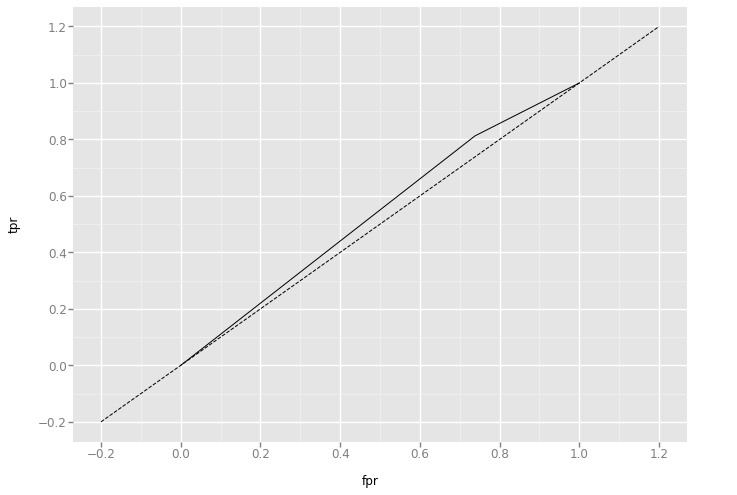

<ggplot: (-9223363280485788805)>

In [338]:
fpr, tpr, _ = metrics.roc_curve(y_test, y_preds)

df = pd.DataFrame(dict(fpr=fpr, tpr=tpr))
ggplot(df, aes(x='fpr', y='tpr')) +\
 geom_line() +\
    geom_abline(linetype='dashed')

## Bayes

In [339]:
y_preds1 = gnb.fit(X_scaled, y_train)

In [340]:
y_preds1 = gnb.predict(X_tests)

In [341]:
b_acs = accuracy_score(y_test, y_pred1)
b_acs

0.7943544738984891

In [342]:
confusion_matrix(y_test, y_preds1)

array([[  212,  4165],
       [  382, 17347]])

In [343]:
B_rs =roc_auc_score(y_test, y_preds1)
B_rs

0.5134441913038653

## Decision Tree

In [344]:
model_tree.fit(X_scaled, y_train)

DecisionTreeClassifier(class_weight=None, criterion='gini', max_depth=None,
            max_features=None, max_leaf_nodes=None,
            min_impurity_decrease=0.0, min_impurity_split=None,
            min_samples_leaf=1, min_samples_split=2,
            min_weight_fraction_leaf=0.0, presort=False, random_state=None,
            splitter='best')

In [345]:
y_preds2 = model_tree.predict(X_tests)

In [346]:
DT_acs = accuracy_score(y_test, y_preds2)
DT_acs

0.7025242015742332

In [347]:
confusion_matrix(y_test, y_preds2)

array([[ 1129,  3248],
       [ 3328, 14401]])

In [348]:
DT_rs = roc_auc_score(y_test, y_preds2)
DT_rs

0.5351120923159718

## Random Forest

In [349]:
model_RR.fit(X_scaled, y_train)

RandomForestClassifier(bootstrap=True, class_weight=None, criterion='gini',
            max_depth=None, max_features='auto', max_leaf_nodes=None,
            min_impurity_decrease=0.0, min_impurity_split=None,
            min_samples_leaf=1, min_samples_split=2,
            min_weight_fraction_leaf=0.0, n_estimators=5, n_jobs=1,
            oob_score=False, random_state=None, verbose=0,
            warm_start=False)

In [350]:
y_preds3 = model_RR.predict(X_tests)

In [351]:
RF_acs = accuracy_score(y_test, y_preds3)
RF_acs

0.7409300642359541

In [352]:
confusion_matrix(y_test, y_preds3)

array([[  873,  3504],
       [ 2223, 15506]])

In [353]:
RF_rs = roc_auc_score(y_test, y_preds3)
RF_rs

0.5370319482517443

A slight imporvement in the results of all classifications afer the scaling. An interseting performance by the logistic classifier with the scaled data after the failure on the normal data set, this imporvement is best noticed through the confusion matrix. 

# Incorrectly classified? 

Do some exploratory data analysis on the incorrectly classified rows of data. What can you learn aobut this subset? How does it compare to the dataset as a whole or even look at how it compares to the set of correctly classified instances. Does this inspire any further preprocessing of the data or perhaps some additional variables that you could add? If so add them and investigate the results.<br>

Use either the GridSearchCV or RandomizedSearchCV class to try to find the best values for the hyperparameters for one or more of your algorithms. You should use the sklearn documenation to select some hyper parameters as well as for the details of how to use the Grid or Randomized search models.<br>

Finally, the ensemble learning idea could really help improve your results. That is use all three (or more) of your models and have them vote on the final classification. You can implement a simple Python class that provides a fit and predict method.

## Logistic

In [354]:
df = y_test.copy()

In [355]:
df['Logistic'] = y_pred2

In [356]:
df['correct?'] = np.where((df['show_up'] == df['Logistic'])
                     , "Yes", "No")

In [357]:
df.head()

,show_up,Logistic,correct?
30946,1,1,Yes
55057,1,1,Yes
72035,1,1,Yes
54260,0,1,No
50290,1,1,Yes


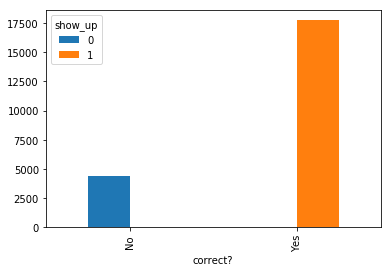

In [358]:
bar = df[['correct?', 'show_up']].groupby(['correct?', 'show_up'])['show_up'].count().unstack('show_up')
bar.plot(kind='bar', stacked=False)

In [359]:
Logistic_inc = df[(df['correct?'] == "No")]

In [360]:
Logistic_inc

,show_up,Logistic,correct?
54260,0,1,No
82578,0,1,No
109696,0,1,No
60300,0,1,No
53975,0,1,No
72744,0,1,No
102971,0,1,No
59787,0,1,No
29494,0,1,No
3284,0,1,No


In [361]:
in_correct_log = data[data.index.isin(Logistic_inc.index)]

In [362]:
in_correct_log.head()

,PatientId,Gender,Age,Scholarship,Hipertension,Diabetes,Alcoholism,Handcap,SMS_received,show_up,Month,day_of_week,Appointment_Hour,AgeCategory,TimeofDay
11,7.542951e+12,1,29,0,0,0,0,0,1,0,4,0,8,0,1
31,3.112849e+11,1,12,1,0,0,0,0,0,0,4,0,12,2,3
128,9.488697e+14,0,34,1,0,0,0,0,1,0,4,0,9,0,1
237,5.369588e+12,0,27,1,0,0,0,0,1,0,4,0,13,0,0
252,3.353686e+12,0,18,0,0,0,0,0,0,0,4,0,14,0,0


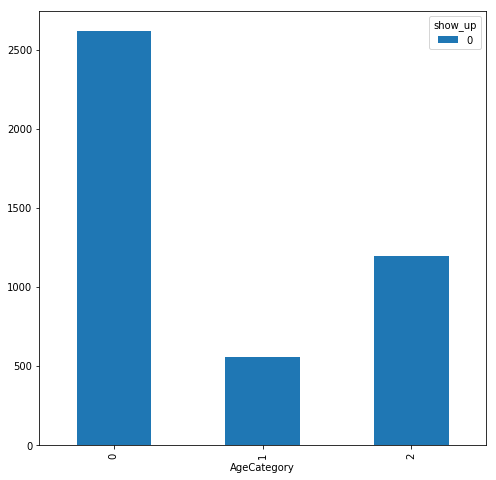

In [363]:
age = pd.crosstab(in_correct_log.AgeCategory, in_correct_log.show_up)
age.plot(kind="bar", 
                 figsize=(8,8),
                 stacked=True)

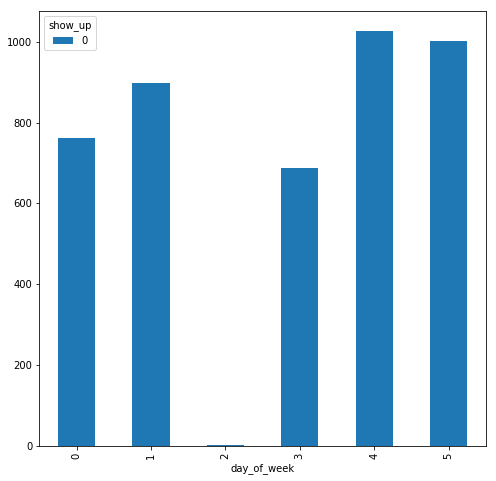

In [364]:
day = pd.crosstab(in_correct_log.day_of_week, in_correct_log.show_up)
day.plot(kind="bar", 
                 figsize=(8,8),
                 stacked=True)

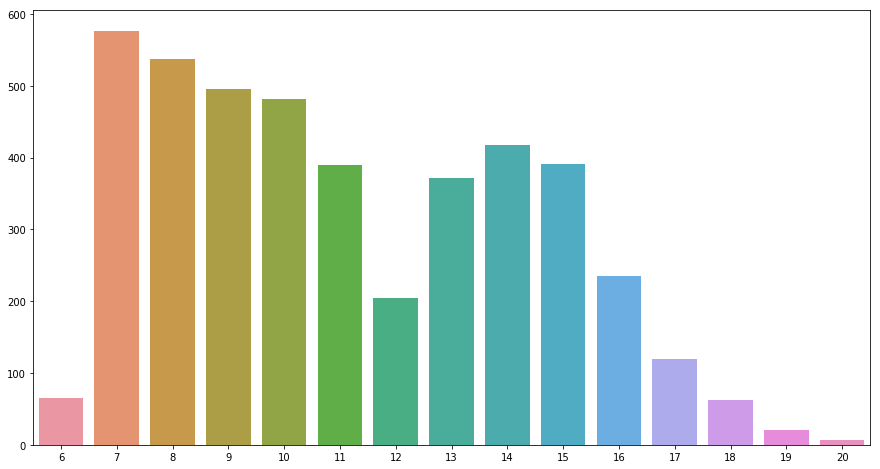

In [365]:
groups =in_correct_log.groupby(['Appointment_Hour'])
gps = groups.size()
fig, ax = plt.subplots(figsize=(15,8))
sbs.barplot(x=gps.index.tolist(), y=gps.values)

In [384]:
in_correct_log.head()

,PatientId,Gender,Age,Scholarship,Hipertension,Diabetes,Alcoholism,Handcap,SMS_received,show_up,Month,day_of_week,Appointment_Hour,AgeCategory,TimeofDay
11,7.542951e+12,1,29,0,0,0,0,0,1,0,4,0,8,0,1
31,3.112849e+11,1,12,1,0,0,0,0,0,0,4,0,12,2,3
128,9.488697e+14,0,34,1,0,0,0,0,1,0,4,0,9,0,1
237,5.369588e+12,0,27,1,0,0,0,0,1,0,4,0,13,0,0
252,3.353686e+12,0,18,0,0,0,0,0,0,0,4,0,14,0,0


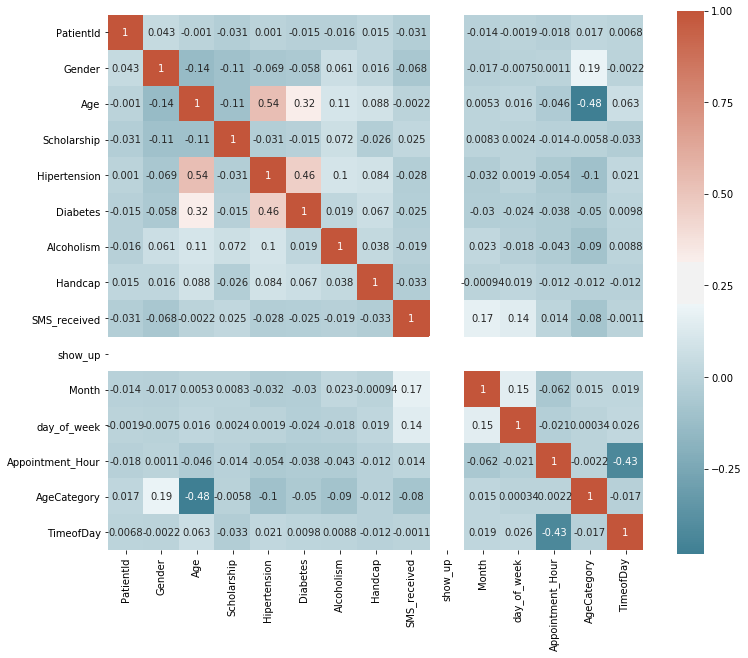

In [367]:
corr = in_correct_log.corr()
fig, ax = plt.subplots(figsize=(12, 10))
cmap = sns.diverging_palette(220, 20, sep=20,as_cmap=True)
fig = sns.heatmap( corr, cmap=cmap, square=True, ax=ax, annot=True )
plt.show()

Through the analysis of the incorrectly classified rows, I did not notice any trend.

## Grid Search

In [377]:
import numpy as np
from sklearn import linear_model, datasets
from sklearn.model_selection import GridSearchCV

In [378]:
logistic = linear_model.LogisticRegression()

In [379]:
penalty = ['l1', 'l2']

C = np.logspace(0, 4, 10)

hyperparameters = dict(C=C, penalty=penalty)

In [380]:
clf = GridSearchCV(logistic, hyperparameters, cv=5, verbose=0)

In [381]:
best_model = clf.fit(X_train, y_train)

In [382]:
print('Best Penalty:', best_model.best_estimator_.get_params()['penalty'])
print('Best C:', best_model.best_estimator_.get_params()['C'])

Best Penalty: l1
Best C: 1.0


In [385]:
prediction = best_model.predict(X_test)

In [386]:
accuracy_score(y_test, prediction)

0.8019994571609518

# All calssifiers in one

In [368]:
from sklearn import model_selection
from sklearn.linear_model import LogisticRegression
from sklearn.tree import DecisionTreeClassifier
from sklearn.svm import SVC
from sklearn.ensemble import VotingClassifier

In [369]:
seed = 10
kfold = model_selection.KFold(n_splits=10, random_state=seed)
estimators = []
model1 = LogisticRegression()
estimators.append(('logistic', model1))
model2 = GaussianNB()
estimators.append(('Bayes', model2))
model3 = DecisionTreeClassifier()
estimators.append(('DT', model3))
model4 = RandomForestClassifier(5)
estimators.append(('RF', model4))
# create the ensemble model
ensemble = VotingClassifier(estimators)
results = model_selection.cross_val_score(ensemble, X_scaled, y_train, cv=kfold)
print(results.mean())

0.7490641644513097


Another way

In [370]:
SEED = 222
np.random.seed(SEED)

In [371]:
from sklearn.naive_bayes import GaussianNB
from sklearn.ensemble import RandomForestClassifier, GradientBoostingClassifier
from sklearn.linear_model import LogisticRegression
from sklearn.neighbors import KNeighborsClassifier
from sklearn.kernel_approximation import Nystroem
from sklearn.kernel_approximation import RBFSampler
from sklearn.pipeline import make_pipeline


def get_models():
    nb = GaussianNB()
    lr = LogisticRegression(C=100, random_state=SEED)
    rf = RandomForestClassifier(n_estimators=10, max_features=3, random_state=SEED)
    dt = DecisionTreeClassifier()

    models = {
              'logistic': lr,
              'naive bayes': nb,
              'decision tree': dt,
              'random forest': rf,
            
              }

    return models


def train_predict(model_list):
    P = np.zeros((y_test.shape[0], len(model_list)))
    P = pd.DataFrame(P)

    print("Fitting models.")
    cols = list()
    for i, (name, m) in enumerate(models.items()):
        print("%s..." % name, end=" ", flush=False)
        m.fit(X_train, y_train)
        P.iloc[:, i] = m.predict_proba(X_test)[:, 1]
        cols.append(name)
        print("done")

    P.columns = cols
    print("Done.\n")
    return P


def score_models(P, y):
    print("Scoring models.")
    for m in P.columns:
        score = roc_auc_score(y, P.loc[:, m])
        print("%-26s: %.3f" % (m, score))
    print("Done.\n")


In [372]:
models = get_models()
P = train_predict(models)
score_models(P, y_test)

Fitting models.
random forest... done
naive bayes... done
logistic... done
decision tree... done
Done.

Scoring models.
random forest             : 0.570
naive bayes               : 0.592
logistic                  : 0.612
decision tree             : 0.545
Done.



In [373]:
print("Ensemble ROC-AUC score: %.3f" % roc_auc_score(y_test, P.mean(axis=1)))


Ensemble ROC-AUC score: 0.595


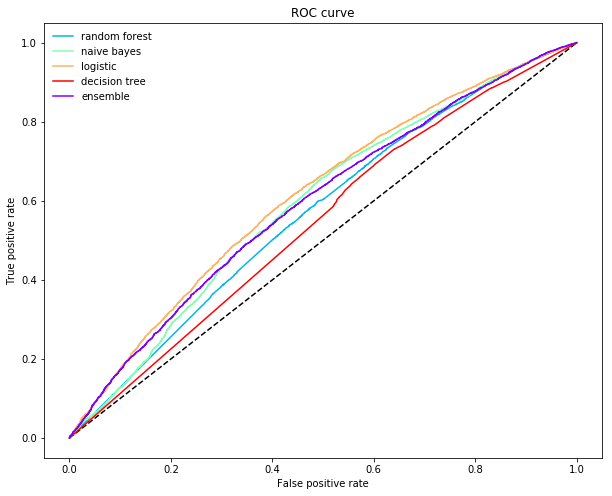

In [374]:
from sklearn.metrics import roc_curve

def plot_roc_curve(y_test, P_base_learners, P_ensemble, labels, ens_label):
    plt.figure(figsize=(10, 8))
    plt.plot([0, 1], [0, 1], 'k--')
    
    cm = [plt.cm.rainbow(i)
      for i in np.linspace(0, 1.0, P_base_learners.shape[1] + 1)]
    
    for i in range(P_base_learners.shape[1]):
        p = P_base_learners[:, i]
        fpr, tpr, _ = roc_curve(y_test, p)
        plt.plot(fpr, tpr, label=labels[i], c=cm[i + 1])

    fpr, tpr, _ = roc_curve(y_test, P_ensemble)
    plt.plot(fpr, tpr, label=ens_label, c=cm[0])
        
    plt.xlabel('False positive rate')
    plt.ylabel('True positive rate')
    plt.title('ROC curve')
    plt.legend(frameon=False)
    plt.show()


plot_roc_curve(y_test, P.values, P.mean(axis=1), list(P.columns), "ensemble")

Lets apply the same on the scaled data and see if there is any difference

In [375]:
def get_models():
    nb = GaussianNB()
    lr = LogisticRegression(C=100, random_state=SEED)
    rf = RandomForestClassifier(n_estimators=10, max_features=3, random_state=SEED)
    dt = DecisionTreeClassifier()

    models = {
              'logistic': lr,
              'naive bayes': nb,
              'decision tree': dt,
              'random forest': rf,
            
              }

    return models


def train_predict(model_list):
    P = np.zeros((y_test.shape[0], len(model_list)))
    P = pd.DataFrame(P)

    print("Fitting models.")
    cols = list()
    for i, (name, m) in enumerate(models.items()):
        print("%s..." % name, end=" ", flush=False)
        m.fit(X_scaled, y_train)
        P.iloc[:, i] = m.predict_proba(X_tests)[:, 1]
        cols.append(name)
        print("done")

    P.columns = cols
    print("Done.\n")
    return P


def score_models(P, y):
    """Score model in prediction DF"""
    print("Scoring models.")
    for m in P.columns:
        score = roc_auc_score(y, P.loc[:, m])
        print("%-26s: %.3f" % (m, score))
    print("Done.\n")
    


In [376]:
models = get_models()
P = train_predict(models)
score_models(P, y_test)


Fitting models.
random forest... done
naive bayes... done
logistic... done
decision tree... done
Done.

Scoring models.
random forest             : 0.571
naive bayes               : 0.592
logistic                  : 0.612
decision tree             : 0.543
Done.



Noticeable improvements in the ROC curve scores.